# Análisis de Canastas para los Supermercados en México

## Eduardo Zago y Miguel Lerdo de Tejada

#### Cargamos las librerias

In [71]:
options(warn=-1)

paquetes<-c("tidyverse","lubridate","stringr","janitor","tm","arules", "haven","tidygraph","ggraph")

sapply(paquetes,
       function(x) {
         if(!x %in% rownames(installed.packages()))
           install.packages(x)
         require(x, character.only=T)})
rm(list=setdiff(ls(),c("")))

tidyverse lubridate   stringr   janitor        tm    arules     haven tidygraph 
     TRUE      TRUE      TRUE      TRUE      TRUE      TRUE      TRUE      TRUE 
   ggraph 
     TRUE

#### Funciones

In [72]:
tab <- function(frame_x, var_name){
     var_name <- enquo(var_name)
     frame_x |>
          group_by(!!var_name) |>
          summarise(n = n()) |>
          mutate(totalN = (cumsum(n)),
                 percent = round((n / sum(n)), 3),
                 cumuPer = round(cumsum(freq = n / sum(n)), 3))
}

agregar_hyperlift <- function(reglas, trans){
  quality(reglas) <- cbind(quality(reglas), 
 hyper_lift = interestMeasure(reglas, measure = "hyperLift", 
 transactions = trans))
  reglas
}

datosAnuales <- function(clean){
    datos_final <- clean |> 
mutate(subproduto1 = ifelse(subproduto == "SIN SUBPRODUCTO" |
                                            subproduto == "SEM SUBPRODUTO", NA, subproduto)) |>
mutate(articulo = ifelse(is.na(subproduto1) == F, paste0(produto," ",subproduto), produto)) |> 
select(canasta, articulo, canal, iddomicilio, data_compra)
head(datos_final, 20)
    
    datos_final <- datos_final |> 
mutate(across(c(articulo), tolower)) |> 
mutate(across(c(articulo), ~ str_replace_all(.x, "  ", " "))) |> 
mutate(across(c(articulo), ~ str_replace_all(.x, " ", "_")))

    canastas <- datos_final |> 
group_by(canasta) |> 
summarise(basket = toString(unique(articulo))) |> 
mutate(canastas = str_replace_all(basket, ",", ""))
    
    canastas_l <- split(canastas$canastas, seq(nrow(canastas)))
canastas_l <- map(canastas_l,  ~strsplit(.x, "\\s+")[[1]])
    
    return(canastas_l)

}
graficas <- function(canastas,hl,agno){
    reglas_recetas <- apriori(canastas, parameter = pars,control=list(verbose = FALSE))
    reglas_recetas <- agregar_hyperlift(reglas_recetas, canastas)
    DT::datatable(DATAFRAME(sort(reglas_recetas,by = "hyper_lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))
    
    ### Reglas con hyperlift alto
    reglas_1_low <- subset(reglas_recetas, hyper_lift > hl & confidence > 0.1) 
    reglas_tam_2_low <- subset(reglas_1_low, size(reglas_1_low) == 2)

    # Grafica

    df_reglas <- reglas_tam_2_low |> DATAFRAME() |> 
      rename(from=LHS, to=RHS) |> as_data_frame()
    df_reglas$weight <- log(df_reglas$hyper_lift)
    graph_1 <- as_tbl_graph(df_reglas) |>
      mutate(centrality = centrality_degree(mode = "all")) 
    graf <- ggraph(graph_1, layout = 'fr', start.temp=100) +
      geom_edge_link(aes(alpha=lift), 
                     colour = 'red',
                     arrow = arrow(length = unit(4, 'mm'))) + 
      geom_node_point(aes(size = centrality, colour = centrality)) + 
      geom_node_text(aes(label = name), size=4,
                     colour = 'gray20', repel=TRUE) +
      theme_graph(base_family = "sans") +
    ggtitle(paste0("ano ",agno))
                print(graf)

}

## Datos

Realizamos un análisis de canastas con algoritmo apriori de los tickets de supermercados de familias mexicanas durante 5 años (2010 a 2014). Para esto utilizamos una base de datos de Kantar, la cual sigue a una muestra de 8500 familias y les pide sus tickets (semanalmente) del Supermercado, Tiendas Oxxo, K, Abarrotes, etc. durante 6 años, también recolectando información sociodemográfica de las familias. Tenemos entre 2 y 3 millones de artículos comprados por año.

Nos interesa ver itemsets frecuentes y complementariedad, tanto en general como en submuestras. La riqueza de nuestros datos nos permitió realizar un análisis en el tiempo, así como por body-mass index (BMI) alto vs bajo y por nivel socioeconómico (NSE). 

Los datos demográficos son recolectados cada año. Contamos con el BMI del jefe de familia y el nivel socieconómico medido en categorías (AB, C+, C, D+, D y E). En este caso, le asignamos a cada hogar la moda del BMI y del NSE. En este trabajo decidimos no analizar los cambios en el tiempo cuando mejoran o empeoran BMI o NSE, por lo que la solución más práctica fue asignarles un valor único a cada hogar. 

Si dividíamos siguiendo la clasificación de obesidad y sobrepeso para México, nos quedábamos con prácticamente puros hogar de BMI alto. En ese sentido, un hogar tiene BMI alto si el valor del BMI es mayor a la mediana de la muestra. De igual manera, un hogar tiene NSE alto si pertence a las categorías AB, C+ o C. 


In [73]:
health <- read_dta("/home/data/kantar/Health_class.dta")

In [74]:
clean2010 <- as_tibble(read_dta("base_2010.zip"))

In [75]:
clean2011 <- as_tibble(read_dta("base_2011.dta"))

In [76]:
clean2012 <- as_tibble(read_dta("base_2012.dta"))

In [77]:
clean2013 <- as_tibble(read_dta("base_2013.dta"))

In [78]:
clean2014 <- as_tibble(read_dta("base_2014.dta"))

In [79]:
clean <- rbind(clean2010,clean2011,clean2012,clean2013,clean2014) |>
left_join(health, by = c("idartigo"), suffix = c("", ".y")) |>
mutate(food=ifelse(!is.na(health),1,0))

In [80]:
datos_final <- clean |> 
mutate(subproduto1 = ifelse(subproduto == "SIN SUBPRODUCTO" |
                                            subproduto == "SEM SUBPRODUTO", NA, subproduto)) |>
mutate(articulo = ifelse(is.na(subproduto1) == F, paste0(produto," ",subproduto), produto)) |> 
select(canasta, articulo, canal, iddomicilio, data_compra, food, high_bmi, nse_2)
head(datos_final, 20)

canasta,articulo,canal,iddomicilio,data_compra,food,high_bmi,nse_2
<dbl>,<chr>,<chr>,<dbl>,<chr>,<dbl>,<dbl>,<dbl+lbl>
128939,CLORO,BODEGA AURRERA,4714,2010-06-14 00:00:00,0,0,1
100939,CLORO,SORIANA,29157,2010-05-08 00:00:00,0,0,1
192721,CLORO,BODEGA AURRERA,61340,2010-08-24 00:00:00,0,0,1
181727,CLORO,COMERCIAL MEXICANA,278,2010-08-13 00:00:00,0,1,1
195426,CLORO,SORIANA,4890,2010-08-28 00:00:00,0,1,2
89684,CLORO,CHEDRAUI,15793,2010-04-21 00:00:00,0,0,2
93192,CLORO,SORIANA,15510,2010-04-26 00:00:00,0,1,2
177763,CLORO,BODEGA AURRERA,21751,2010-08-08 00:00:00,0,1,2
29974,CLORO,SORIANA,6784,2010-02-07 00:00:00,0,0,1


In [81]:
datos_final <- datos_final |> 
mutate(across(c(articulo), tolower)) |> 
mutate(across(c(articulo), ~ str_replace_all(.x, "  ", " "))) |> 
mutate(across(c(articulo), ~ str_replace_all(.x, " ", "_")))

head(datos_final, 20)

canasta,articulo,canal,iddomicilio,data_compra,food,high_bmi,nse_2
<dbl>,<chr>,<chr>,<dbl>,<chr>,<dbl>,<dbl>,<dbl+lbl>
128939,cloro,BODEGA AURRERA,4714,2010-06-14 00:00:00,0,0,1
100939,cloro,SORIANA,29157,2010-05-08 00:00:00,0,0,1
192721,cloro,BODEGA AURRERA,61340,2010-08-24 00:00:00,0,0,1
181727,cloro,COMERCIAL MEXICANA,278,2010-08-13 00:00:00,0,1,1
195426,cloro,SORIANA,4890,2010-08-28 00:00:00,0,1,2
89684,cloro,CHEDRAUI,15793,2010-04-21 00:00:00,0,0,2
93192,cloro,SORIANA,15510,2010-04-26 00:00:00,0,1,2
177763,cloro,BODEGA AURRERA,21751,2010-08-08 00:00:00,0,1,2
29974,cloro,SORIANA,6784,2010-02-07 00:00:00,0,0,1


In [82]:
canastas <- datos_final |> 
group_by(canasta) |> 
summarise(basket = toString(unique(articulo))) |> 
mutate(canastas = str_replace_all(basket, ",", ""))

head(canastas, 10)

canasta,basket,canastas
<dbl>,<chr>,<chr>
1,"yogurt_batido, chocolate_de_mesa_sem_producto, botanas",yogurt_batido chocolate_de_mesa_sem_producto botanas
2,modificadores_de_leche,modificadores_de_leche
3,servilletas_de_papel,servilletas_de_papel
4,"proteccion_femenina_pantiprotector, bebidas_gaseosas_con_sabor_regular, leche_saborizada_base_soya, yogurt_liquido, cereales_para_el_desayuno, pan_industrializado, modeladores_para_el_cabello_gel",proteccion_femenina_pantiprotector bebidas_gaseosas_con_sabor_regular leche_saborizada_base_soya yogurt_liquido cereales_para_el_desayuno pan_industrializado modeladores_para_el_cabello_gel
5,"margarina_margarina, suavizantes_e_intensificadores_suavizante, papel_higienico, yogurt_batido, limpiadores_multiuso/perfumado/piso, cloro, yogurt_lacteos_fermentados, shampoo_anticaspa",margarina_margarina suavizantes_e_intensificadores_suavizante papel_higienico yogurt_batido limpiadores_multiuso/perfumado/piso cloro yogurt_lacteos_fermentados shampoo_anticaspa
6,desodorantes_corpo,desodorantes_corpo
7,"jabon_de_tocador_solido, modificadores_de_leche, detergente_ropa_polvo, pañales_desechable",jabon_de_tocador_solido modificadores_de_leche detergente_ropa_polvo pañales_desechable
8,cremas_para_la_piel_crema,cremas_para_la_piel_crema
9,leche_liquida_ultra_pasteurizado_uht,leche_liquida_ultra_pasteurizado_uht


In [83]:
canastas_l <- split(canastas$canastas, seq(nrow(canastas)))
canastas_l <- map(canastas_l,  ~strsplit(.x, "\\s+")[[1]])

## Motivación

El análisis de reglas de asociación, en especial para tickets de compra de supermercados, es de gran utilidad para encontrar elementos que se compran juntos de manera frecuente. Esta información es de utilidad ya que te permite tomar decisiones que beneficien tanto al productor como al consumidor. Hay que recordar que los conjuntos frecuentes indican asociaciones (y cuantificaciones de la asociación) entre artículos que hay que tomar en cuenta al momento de tomar decisiones (Notas de Clase). Del lado de los supermercados, al ver que dos artículos se compran frecuentemente, podría beneficiarse de esta información y juntarlos en estantes cercanos (en beneficio del consumidor) o alejarlos (como se compran siempre juntos, al alejarlos obligas al consumidor a recorrer el super y ver más artículos que pudieran ser de su interés, por lo tanto, a comprar más). También, existen supermercados que se enfocan en cierta parte de la población, por lo que entender las reglas de asociación de estas submuestras también puede ser de utilidad (Supermercados que se enfocan en individuos de ingreso más alto, como CitiMarket).

En otro sentido, a nosotros como economistas también nos parece interesante observar que itemsets frecuentes se compran en distintas submuestras, y las distintas reglas de asociación que existen entre ellas. Podría ser de interés determinar qué tipo de productos consumen más frecuentemente los individuos en los deciles bajos, si son productos más saludables, de mejor sabor, pero con más azúcar, etc. (búsqueda de placeres instantáneos (Poor Economics, Duflo & Banerjee). 


## Algoritmo a priori
Recordando estas tres características de los datos en canastas

1. El número de canastas puede ser mucho mayor (en algunos casos miles de millones) y quizá no pueden leerse completas en memoria.
2. La mayoría de los artículos ocurre con frecuencias relativamente bajas, aunque unos cuantos tienen frecuencia alta.
3. El número de canastas distintas es alto, y hay pocas canastas frecuentes.

En nuestro caso, tan solo para 2010, observamos alrededor de 300 mil canastas, agregadas a 168 categorías. Realizar un análisis de conjuntos frecuentes sería inviable, más aún si agregamos los otros 4 años que tenemos. Por lo tanto, utilizando el principio de monotonicidad de itemsets, hace que la búsqueda y conteo de itemsets frecuentes sea un problema factible, pues podemos descartar una gran cantidad de artículos o itemsets a priori de manera simple y no necesitamos contar todo y guardarlo en memoria. 


## 1. Todas las Canastas

Empezamos el análisis inclueyendo todos los años y todos los distintos grupos que podemos generar. Para el algoritmo utilizamos un soporte de 0.01, el mismo que fue elegido al ser el que mejor resultados brindaba, después de probar con otros.

In [84]:
pars <- list(support = 0.01,  target = 'frequent itemsets',
             ext = TRUE)
ap_canastas <- apriori(canastas_l , parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
         NA    0.1    1 none FALSE            TRUE       5    0.01      1
 maxlen            target  ext
     10 frequent itemsets TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 20561 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[184 item(s), 2056169 transaction(s)] done [1.16s].
sorting and recoding items ... [84 item(s)] done [0.22s].
creating transaction tree ... done [2.07s].
checking subsets of size 1 2 3 4 5 6 done [2.33s].
sorting transactions ... done [0.79s].
writing ... [2929 set(s)] done [0.00s].
creating S4 object  ... done [0.49s].


### Conjuntos frecuentes:

Observamos que los conjuntos más frecuentes son artículos de aseo, como detergente, cloro, papel higiénico y jabón de tocador. Así como comida, como la pasta seca, que es un platillo muy famoso en la comida hogareña mexicana. 

In [85]:
ap_2 <- subset(ap_canastas, size(ap_canastas) == 1)
frecs <- ap_2 |> sort(by = 'support') |> DATAFRAME()
DT::datatable(frecs |> mutate_if(is.numeric, function(x) round(x, 3)))

HTML widgets cannot be represented in plain text (need html)

In [86]:

#### Reglas de confianza::

pars <- list(support = 0.01, confidence = 0.10,
             target = 'rules',
             ext = TRUE, minlen = 2)
reglas_recetas <- apriori(canastas_l, parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
        0.1    0.1    1 none FALSE            TRUE       5    0.01      2
 maxlen target  ext
     10  rules TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 20561 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[184 item(s), 2056169 transaction(s)] done [1.16s].
sorting and recoding items ... [84 item(s)] done [0.23s].
creating transaction tree ... done [2.03s].
checking subsets of size 1 2 3 4 5 6 done [2.34s].
writing ... [9128 rule(s)] done [0.00s].
creating S4 object  ... done [0.48s].


Posteriormente observamos las reglas de asociación entre artículos, ordenando por lift para observar las asociaciones más fuertes. En principio podemos observar que los artículos de aseo, en general, se compran al mismo tiempo. Por ejemplo, toallas de papel y papel higiénico, detergente y suavizantes. También observamos la relación más fuerte es entre leche condensada y leche evaporada, lo cual parece ser raro ya que ambos productos son similares, y solo se diferencian en la cantidad de agua y azucar que se le agrega a ambos. Es raro porque tecnicámente cumplen el mismo proposito.

In [87]:
DT::datatable(DATAFRAME(sort(reglas_recetas, by = "lift", decreasing = TRUE)[1:10,]) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))

HTML widgets cannot be represented in plain text (need html)

In [88]:
#### Hyperlift::
reglas_recetas <- agregar_hyperlift(reglas_recetas, canastas_l)

In [89]:
DT::datatable(DATAFRAME(sort(reglas_recetas,by = "hyper_lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))

HTML widgets cannot be represented in plain text (need html)

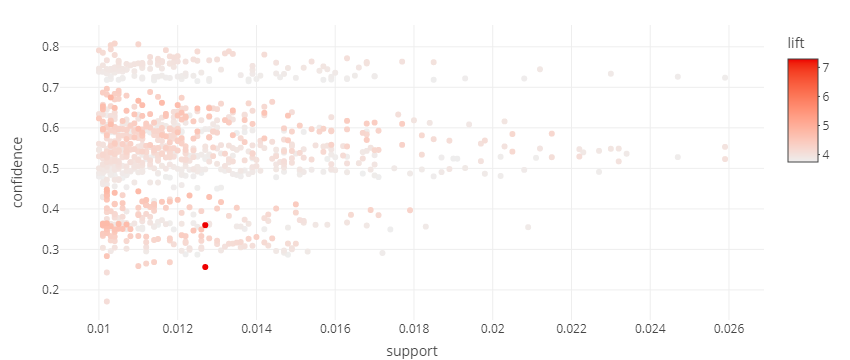

In [90]:
### Pares comunes

library(arulesViz)
reglas_1 <- subset(reglas_recetas, hyper_lift > 1.1 & support > 0.01 & confidence > 0.10)

reglas_tam_2 <- subset(reglas_1, size(reglas_1)==2)
#inspect(reglas_tam_2 |> sort(by = 'hyper_lift')) 
plot(reglas_1 |> subset(support > 0.001), engine = "plotly")

Por último, agregamos el hyperlift como otra medida de la fuerza de la asociación, ya que como visto en clase al utilizar hyper-lift para filtrar reglas en lugar de lift obtenemos reglas de mejor calidad. Esto principalmente por 3 razones:
1. Descartamos más reglas de soporte bajo que tienen lift alto por azar.
2. Los valores de soporte de las reglas tienden a ser más altos.
3. Los valores de lift son comparables

Analizando la gráfica vemos otras asociaciones interesantes, como las botanas con refrescos (galletas saladas, dulces con refrescos con gas y papas, jugos con yogurt (desayunos y cenas)).

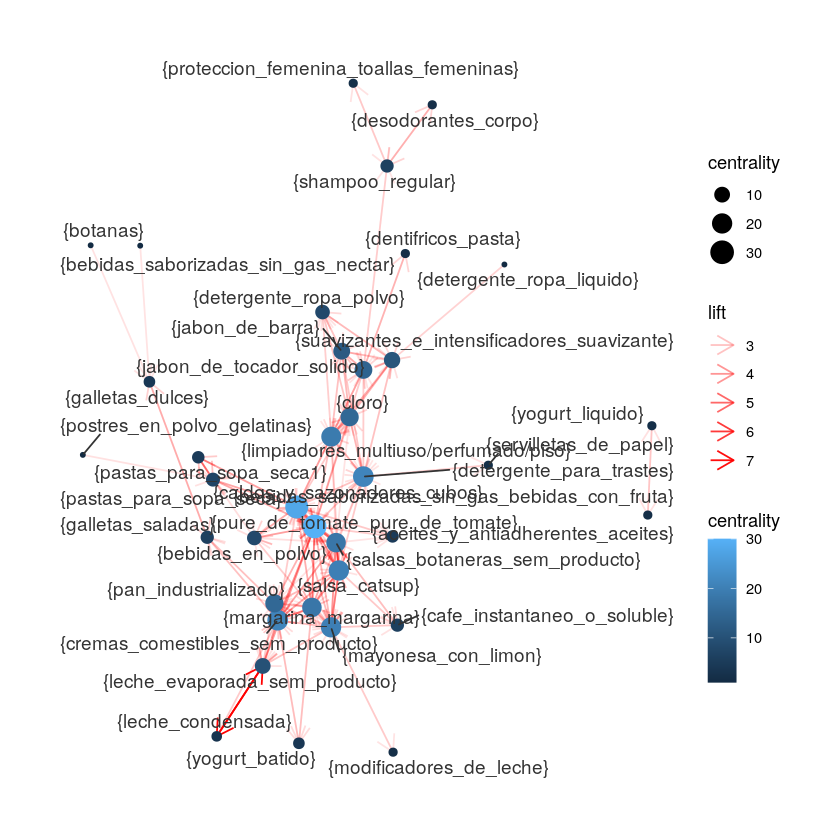

In [91]:
### Reglas con hyperlift alto
reglas_1 <- subset(reglas_recetas, hyper_lift > 2.2 & confidence > 0.1)

reglas_tam_2 <- subset(reglas_1, size(reglas_1) == 2)


# Grafica


df_reglas <- reglas_tam_2 |> DATAFRAME() |> 
  rename(from=LHS, to=RHS) |> as_data_frame()
df_reglas$weight <- log(df_reglas$hyper_lift)
graph_1 <- as_tbl_graph(df_reglas) |>
  mutate(centrality = centrality_degree(mode = "all")) 
ggraph(graph_1, layout = 'fr', start.temp=100) +
  geom_edge_link(aes(alpha=lift), 
                 colour = 'red',
                 arrow = arrow(length = unit(4, 'mm'))) + 
  geom_node_point(aes(size = centrality, colour = centrality)) + 
  geom_node_text(aes(label = name), size=4,
                 colour = 'gray20', repel=TRUE) +
  theme_graph(base_family = "sans")

### Con comida

Repetimos el análisis anterior pero sólo con los artículos que son comida.

In [92]:
canastas_comida <- datos_final |> 
filter(food==1) |>
group_by(canasta) |> 
summarise(basket = toString(unique(articulo))) |> 
mutate(canastas = str_replace_all(basket, ",", ""))

head(canastas, 10)

canasta,basket,canastas
<dbl>,<chr>,<chr>
1,"yogurt_batido, chocolate_de_mesa_sem_producto, botanas",yogurt_batido chocolate_de_mesa_sem_producto botanas
2,modificadores_de_leche,modificadores_de_leche
3,servilletas_de_papel,servilletas_de_papel
4,"proteccion_femenina_pantiprotector, bebidas_gaseosas_con_sabor_regular, leche_saborizada_base_soya, yogurt_liquido, cereales_para_el_desayuno, pan_industrializado, modeladores_para_el_cabello_gel",proteccion_femenina_pantiprotector bebidas_gaseosas_con_sabor_regular leche_saborizada_base_soya yogurt_liquido cereales_para_el_desayuno pan_industrializado modeladores_para_el_cabello_gel
5,"margarina_margarina, suavizantes_e_intensificadores_suavizante, papel_higienico, yogurt_batido, limpiadores_multiuso/perfumado/piso, cloro, yogurt_lacteos_fermentados, shampoo_anticaspa",margarina_margarina suavizantes_e_intensificadores_suavizante papel_higienico yogurt_batido limpiadores_multiuso/perfumado/piso cloro yogurt_lacteos_fermentados shampoo_anticaspa
6,desodorantes_corpo,desodorantes_corpo
7,"jabon_de_tocador_solido, modificadores_de_leche, detergente_ropa_polvo, pañales_desechable",jabon_de_tocador_solido modificadores_de_leche detergente_ropa_polvo pañales_desechable
8,cremas_para_la_piel_crema,cremas_para_la_piel_crema
9,leche_liquida_ultra_pasteurizado_uht,leche_liquida_ultra_pasteurizado_uht


In [93]:
canastas_l <- split(canastas_comida$canastas, seq(nrow(canastas_comida)))
canastas_l <- map(canastas_l,  ~strsplit(.x, "\\s+")[[1]])

In [94]:
pars <- list(support = 0.01,  target = 'frequent itemsets',
             ext = TRUE)
ap_canastas <- apriori(canastas_l , parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
         NA    0.1    1 none FALSE            TRUE       5    0.01      1
 maxlen            target  ext
     10 frequent itemsets TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 16426 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[102 item(s), 1642680 transaction(s)] done [0.63s].
sorting and recoding items ... [54 item(s)] done [0.14s].
creating transaction tree ... done [1.46s].
checking subsets of size 1 2 3 4 done [0.50s].
sorting transactions ... done [0.64s].
writing ... [536 set(s)] done [0.00s].
creating S4 object  ... done [0.36s].


### Itemsets frecuentes de tamaño 1

In [95]:
ap_2 <- subset(ap_canastas, size(ap_canastas) == 1)
frecs <- ap_2 |> sort(by = 'support') |> DATAFRAME()
DT::datatable(frecs |> mutate_if(is.numeric, function(x) round(x, 3)))

HTML widgets cannot be represented in plain text (need html)

Notamos la presencia de muchos artículos que esperaríamos encontrar en cualquier cocina nacional. La mayoría son carbohidratos, como la pasta o el pan.  parece ser que la dieta tiene un alto contenido calórico.

In [96]:
#### Reglas de confianza::

pars <- list(support = 0.01, confidence = 0.10,
             target = 'rules',
             ext = TRUE, minlen = 2)
reglas_recetas <- apriori(canastas_l, parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
        0.1    0.1    1 none FALSE            TRUE       5    0.01      2
 maxlen target  ext
     10  rules TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 16426 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[102 item(s), 1642680 transaction(s)] done [0.66s].
sorting and recoding items ... [54 item(s)] done [0.13s].
creating transaction tree ... done [1.43s].
checking subsets of size 1 2 3 4 done [0.51s].
writing ... [1125 rule(s)] done [0.00s].
creating S4 object  ... done [0.37s].


### Reglas de Asociación Ordenadas por Lift

In [97]:
DT::datatable(DATAFRAME(sort(reglas_recetas,by = "lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))

HTML widgets cannot be represented in plain text (need html)

Parecer ser que hay ciertos patrones de compra. Las leches se compran juntas, mientras que los aceites, margarinas y sopas se compran juntos. Procedemos con el análisis agregando el hyperlift, mismo que usaremos para filtrar y graficar las reglas.

In [98]:
#### Hyperlift::
reglas_recetas <- agregar_hyperlift(reglas_recetas, canastas_l)

### Reglas de Asociación Ordenadas por HyperLift

In [99]:
DT::datatable(DATAFRAME(sort(reglas_recetas,by = "hyper_lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))


HTML widgets cannot be represented in plain text (need html)

To reduce overplotting, jitter is added! Use jitter = 0 to prevent jitter.



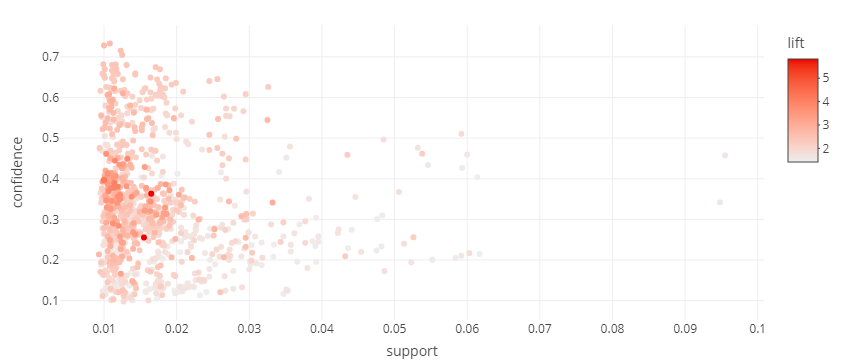

In [100]:
### Pares comunes

library(arulesViz)
reglas_1 <- subset(reglas_recetas, hyper_lift > 1.1 & support > 0.01 & confidence > 0.10)

reglas_tam_2 <- subset(reglas_1, size(reglas_1)==2)
#inspect(reglas_tam_2 |> sort(by = 'hyper_lift')) 
plot(reglas_1 |> subset(support > 0.001), engine = "plotly")

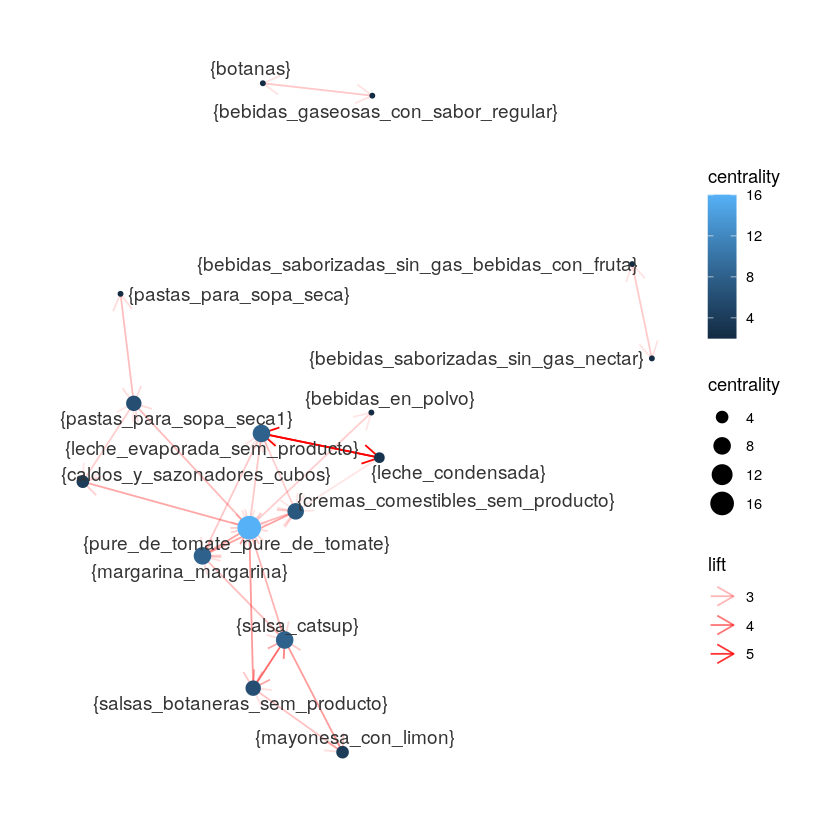

In [101]:
### Reglas con hyperlift alto
reglas_1 <- subset(reglas_recetas, hyper_lift > 2.2 & confidence > 0.1)

reglas_tam_2 <- subset(reglas_1, size(reglas_1) == 2)


# Grafica

library(tidygraph)
library(ggraph)
df_reglas <- reglas_tam_2 |> DATAFRAME() |> 
  rename(from=LHS, to=RHS) |> as_data_frame()
df_reglas$weight <- log(df_reglas$hyper_lift)
graph_1 <- as_tbl_graph(df_reglas) |>
  mutate(centrality = centrality_degree(mode = "all")) 
ggraph(graph_1, layout = 'fr', start.temp=100) +
  geom_edge_link(aes(alpha=lift), 
                 colour = 'red',
                 arrow = arrow(length = unit(4, 'mm'))) + 
  geom_node_point(aes(size = centrality, colour = centrality)) + 
  geom_node_text(aes(label = name), size=4,
                 colour = 'gray20', repel=TRUE) +
  theme_graph(base_family = "sans")

Notamos cuatro grupos: bebidas gaseosas y botanas, bebidas saborizadas, leche y pastas, sopas y pure de tomate. Cada grupo corresponde a ciertas poblaciones y ocasiones en particular.

## Análisis por Ingreso: Comida

Separamos la muestra por NSE y indagamos más en sus hábitos alimenticios.

In [102]:
canastas_lownse <- datos_final |> 
filter(nse_2==1, food==1) |>
group_by(canasta) |> 
summarise(basket = toString(unique(articulo))) |> 
mutate(canastas = str_replace_all(basket, ",", ""))

canastas_highnse <- datos_final |> 
filter(nse_2==2, food==1) |>
group_by(canasta) |> 
summarise(basket = toString(unique(articulo))) |> 
mutate(canastas = str_replace_all(basket, ",", ""))

head(canastas_lownse, 10)
head(canastas_highnse, 10)

canasta,basket,canastas
<dbl>,<chr>,<chr>
1,"yogurt_batido, chocolate_de_mesa_sem_producto, botanas",yogurt_batido chocolate_de_mesa_sem_producto botanas
4,"bebidas_gaseosas_con_sabor_regular, leche_saborizada_base_soya, yogurt_liquido, cereales_para_el_desayuno, pan_industrializado",bebidas_gaseosas_con_sabor_regular leche_saborizada_base_soya yogurt_liquido cereales_para_el_desayuno pan_industrializado
5,"margarina_margarina, yogurt_batido, yogurt_lacteos_fermentados",margarina_margarina yogurt_batido yogurt_lacteos_fermentados
9,leche_liquida_ultra_pasteurizado_uht,leche_liquida_ultra_pasteurizado_uht
10,"salsa_catsup, postres_en_polvo_flanes, leche_saborizada_regular, yogurt_queso_tipo_petit_suisse, cereales_para_el_desayuno",salsa_catsup postres_en_polvo_flanes leche_saborizada_regular yogurt_queso_tipo_petit_suisse cereales_para_el_desayuno
11,"postres_en_polvo_gelatinas, bebidas_gaseosas_con_sabor_regular, postres_en_polvo_flanes, yogurt_lacteos_fermentados, aceites_y_antiadherentes_aceites",postres_en_polvo_gelatinas bebidas_gaseosas_con_sabor_regular postres_en_polvo_flanes yogurt_lacteos_fermentados aceites_y_antiadherentes_aceites
12,"modificadores_de_leche, postre_refrigerado_arroz_con_leche, cereales_para_el_desayuno, bebidas_saborizadas_sin_gas_jugos_puros, galletas_dulces",modificadores_de_leche postre_refrigerado_arroz_con_leche cereales_para_el_desayuno bebidas_saborizadas_sin_gas_jugos_puros galletas_dulces
13,"postres_en_polvo_gelatinas, leche_condensada, mayonesa_aderezo_de_mayonesa, mayonesa_con_limon, aceites_y_antiadherentes_aceites, yogurt_liquido, cremas_comestibles_sem_producto",postres_en_polvo_gelatinas leche_condensada mayonesa_aderezo_de_mayonesa mayonesa_con_limon aceites_y_antiadherentes_aceites yogurt_liquido cremas_comestibles_sem_producto
14,leche_en_polvo_entera,leche_en_polvo_entera


canasta,basket,canastas
<dbl>,<chr>,<chr>
2,modificadores_de_leche,modificadores_de_leche
7,modificadores_de_leche,modificadores_de_leche
20,leche_en_polvo_formula_infantil,leche_en_polvo_formula_infantil
25,"bebidas_gaseosas_con_sabor_regular, cereales_para_el_desayuno, bebidas_en_polvo, leche_liquida_pasteurizada, galletas_dulces, pastas_para_sopa_seca",bebidas_gaseosas_con_sabor_regular cereales_para_el_desayuno bebidas_en_polvo leche_liquida_pasteurizada galletas_dulces pastas_para_sopa_seca
27,aceites_y_antiadherentes_aceites,aceites_y_antiadherentes_aceites
33,"salsa_catsup, leche_liquida_ultra_pasteurizado_uht, pastas_para_sopa_seca",salsa_catsup leche_liquida_ultra_pasteurizado_uht pastas_para_sopa_seca
36,mayonesa_con_limon,mayonesa_con_limon
42,galletas_dulces,galletas_dulces
43,bebidas_gaseosas_con_sabor_regular,bebidas_gaseosas_con_sabor_regular


In [103]:
canastas_low <- split(canastas_lownse$canastas, seq(nrow(canastas_lownse)))
canastas_low <- map(canastas_low,  ~strsplit(.x, "\\s+")[[1]])

canastas_high <- split(canastas_highnse$canastas, seq(nrow(canastas_highnse)))
canastas_high <- map(canastas_high,  ~strsplit(.x, "\\s+")[[1]])

In [104]:
pars <- list(support = 0.01,  target = 'frequent itemsets',
             ext = TRUE)
ap_canastas_low <- apriori(canastas_low , parameter = pars)
ap_canastas_high <- apriori(canastas_high , parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
         NA    0.1    1 none FALSE            TRUE       5    0.01      1
 maxlen            target  ext
     10 frequent itemsets TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 8029 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[102 item(s), 802947 transaction(s)] done [0.33s].
sorting and recoding items ... [55 item(s)] done [0.08s].
creating transaction tree ... done [0.67s].
checking subsets of size 1 2 3 4 done [0.29s].
sorting transactions ... done [0.30s].
writing ... [626 set(s)] done [0.00s].
creating S4 object  ... done [0.19s].
Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
         NA    0.1    1 none FALSE            TRUE       5    0.01      1
 maxlen            target  ext
     10 f

### Itemsets frecuentes de tamaño 1: NSE bajo

In [105]:
ap_2_low <- subset(ap_canastas_low, size(ap_canastas_low) == 1)
frecs <- ap_2_low |> sort(by = 'support') |> DATAFRAME()
DT::datatable(frecs |> mutate_if(is.numeric, function(x) round(x, 3)))

HTML widgets cannot be represented in plain text (need html)

### Itemsets frecuentes de tamaño 1: NSE alto

In [106]:
ap_2_high <- subset(ap_canastas_high, size(ap_canastas_high) == 1)
frecs <- ap_2_high |> sort(by = 'support') |> DATAFRAME()
DT::datatable(frecs |> mutate_if(is.numeric, function(x) round(x, 3)))

HTML widgets cannot be represented in plain text (need html)

In [107]:
#### Reglas de confianza::

pars <- list(support = 0.01, confidence = 0.10,
             target = 'rules',
             ext = TRUE, minlen = 2)
reglas_recetas_low <- apriori(canastas_low, parameter = pars)
reglas_recetas_high <- apriori(canastas_high, parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
        0.1    0.1    1 none FALSE            TRUE       5    0.01      2
 maxlen target  ext
     10  rules TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 8029 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[102 item(s), 802947 transaction(s)] done [0.34s].
sorting and recoding items ... [55 item(s)] done [0.08s].
creating transaction tree ... done [0.68s].
checking subsets of size 1 2 3 4 done [0.29s].
writing ... [1383 rule(s)] done [0.00s].
creating S4 object  ... done [0.18s].
Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
        0.1    0.1    1 none FALSE            TRUE       5    0.01      2
 maxlen target  ext
     10  rules TRUE

Algorithmic control:
 filter tree heap memopt load sort ve

### Reglas de Asociación Ordenadas por Lift: NSE Bajo

In [108]:
DT::datatable(DATAFRAME(sort(reglas_recetas_low,by = "lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))

HTML widgets cannot be represented in plain text (need html)

### Reglas de Asociación Ordenadas por Lift: NSE Alto

In [109]:
DT::datatable(DATAFRAME(sort(reglas_recetas_high,by = "lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))

HTML widgets cannot be represented in plain text (need html)

In [110]:
#### Hyperlift::

reglas_recetas_low <- agregar_hyperlift(reglas_recetas_low, canastas_low)
reglas_recetas_high <- agregar_hyperlift(reglas_recetas_high, canastas_high)

### Reglas de Asociación Ordenadas por HyperLift: NSE Bajo

In [111]:
DT::datatable(DATAFRAME(sort(reglas_recetas_low,by = "hyper_lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))



HTML widgets cannot be represented in plain text (need html)

### Reglas de Asociación Ordenadas por HyperLift: NSE Alto

In [112]:
DT::datatable(DATAFRAME(sort(reglas_recetas_high,by = "hyper_lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))

HTML widgets cannot be represented in plain text (need html)

### Gráfica de las Reglas: NSE bajo

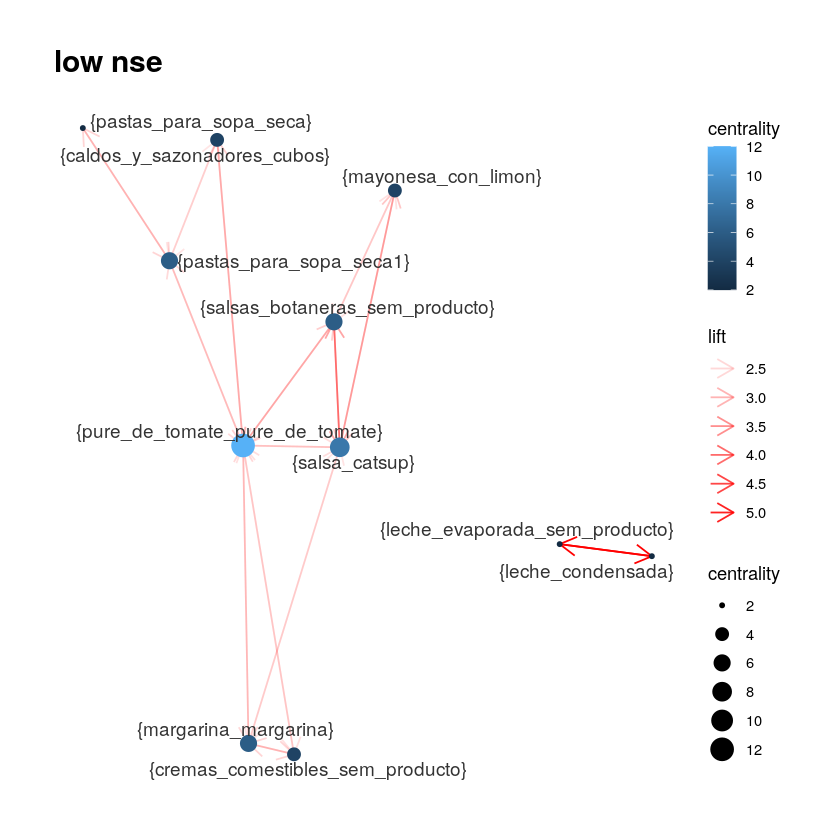

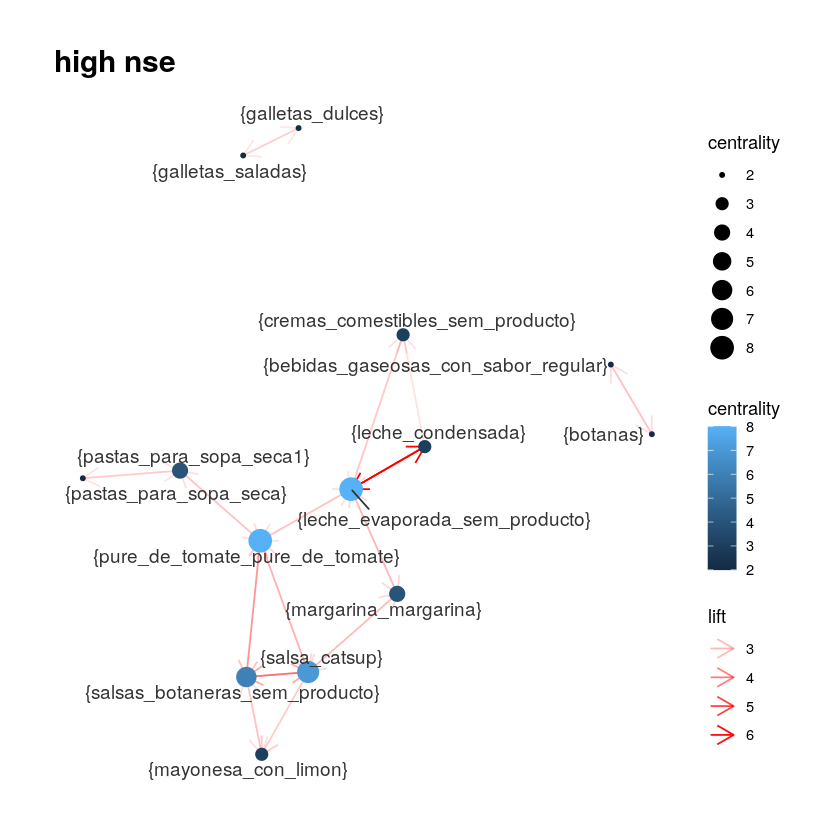

In [113]:
### Reglas con hyperlift alto
reglas_1_low <- subset(reglas_recetas_low, hyper_lift > 2.2 & confidence > 0.1)
reglas_tam_2_low <- subset(reglas_1_low, size(reglas_1_low) == 2)

reglas_1_high <- subset(reglas_recetas_high, hyper_lift > 2.2 & confidence > 0.1)
reglas_tam_2_high <- subset(reglas_1_high, size(reglas_1_low) == 2)

# Grafica


df_reglas <- reglas_tam_2_low |> DATAFRAME() |> 
  rename(from=LHS, to=RHS) |> as_data_frame()
df_reglas$weight <- log(df_reglas$hyper_lift)
graph_1 <- as_tbl_graph(df_reglas) |>
  mutate(centrality = centrality_degree(mode = "all")) 
ggraph(graph_1, layout = 'fr', start.temp=100) +
  geom_edge_link(aes(alpha=lift), 
                 colour = 'red',
                 arrow = arrow(length = unit(4, 'mm'))) + 
  geom_node_point(aes(size = centrality, colour = centrality)) + 
  geom_node_text(aes(label = name), size=4,
                 colour = 'gray20', repel=TRUE) +
  theme_graph(base_family = "sans") +
ggtitle("low nse")

df_reglas <- reglas_tam_2_high |> DATAFRAME() |> 
  rename(from=LHS, to=RHS) |> as_data_frame()
df_reglas$weight <- log(df_reglas$hyper_lift)
graph_1 <- as_tbl_graph(df_reglas) |>
  mutate(centrality = centrality_degree(mode = "all")) 
ggraph(graph_1, layout = 'fr', start.temp=100) +
  geom_edge_link(aes(alpha=lift), 
                 colour = 'red',
                 arrow = arrow(length = unit(4, 'mm'))) + 
  geom_node_point(aes(size = centrality, colour = centrality)) + 
  geom_node_text(aes(label = name), size=4,
                 colour = 'gray20', repel=TRUE) +
  theme_graph(base_family = "sans") +
ggtitle("high nse")

Al comparar ambos grupos observamos el primer resultado interasante. En principio hay dos reglas de asociación que aparecen en el de ingreso alto y no en el de bajo, galletas saladas con dulces y bebidas gaseosas con botanas. En los demás, que son las asociaciones que hemos visto ya (leche condensada, evaporada, margarina, los pures con las salsas y pastas) se mantiene igual entre grupos. Resulta interesante ya que se diferencian principalmente en productos que se disfrutan, que son extras y no indispensables a la comida. También es de notar que son carbohidratos que aportan poco contenido nutricional.

## Análisis por BMI

Nos interesa saber los patrones de consumo de submuestras de la población mexicana que en los datos resultan ser más saludables. Como mencionamos, la riqueza de nuestros datos nos permite observar el BMI de los individuos que realizaron las compras en supermercados y por lo tanto dividir la muestra en dos grupos. Al tratarse del BMI, consideramos de igual manera que analizar solo los artículos de comida era más informativo que todos los posibles artículos.

In [114]:
canastas_lowbmi <- datos_final |> 
filter(high_bmi==0, food==1) |>
group_by(canasta) |> 
summarise(basket = toString(unique(articulo))) |> 
mutate(canastas = str_replace_all(basket, ",", ""))

canastas_highbmi <- datos_final |> 
filter(high_bmi==1, food==1) |>
group_by(canasta) |> 
summarise(basket = toString(unique(articulo))) |> 
mutate(canastas = str_replace_all(basket, ",", ""))

head(canastas_lowbmi, 10)
head(canastas_highbmi, 10)

canasta,basket,canastas
<dbl>,<chr>,<chr>
7,modificadores_de_leche,modificadores_de_leche
10,"salsa_catsup, postres_en_polvo_flanes, leche_saborizada_regular, yogurt_queso_tipo_petit_suisse, cereales_para_el_desayuno",salsa_catsup postres_en_polvo_flanes leche_saborizada_regular yogurt_queso_tipo_petit_suisse cereales_para_el_desayuno
11,"postres_en_polvo_gelatinas, bebidas_gaseosas_con_sabor_regular, postres_en_polvo_flanes, yogurt_lacteos_fermentados, aceites_y_antiadherentes_aceites",postres_en_polvo_gelatinas bebidas_gaseosas_con_sabor_regular postres_en_polvo_flanes yogurt_lacteos_fermentados aceites_y_antiadherentes_aceites
14,leche_en_polvo_entera,leche_en_polvo_entera
15,"cremas_comestibles_sem_producto, cafe_instantaneo_o_soluble",cremas_comestibles_sem_producto cafe_instantaneo_o_soluble
16,"aceites_y_antiadherentes_aceites, leche_liquida_ultra_pasteurizado_uht",aceites_y_antiadherentes_aceites leche_liquida_ultra_pasteurizado_uht
18,"aceites_y_antiadherentes_aceites, helados_y_paletas_helado, cafe_instantaneo_o_soluble",aceites_y_antiadherentes_aceites helados_y_paletas_helado cafe_instantaneo_o_soluble
20,leche_en_polvo_formula_infantil,leche_en_polvo_formula_infantil
21,"yogurt_liquido, yogurt_lacteos_fermentados, barras_de_cereal_regular, yogurt_queso_tipo_petit_suisse, yogurt_batido, leche_liquida_ultra_pasteurizado_uht",yogurt_liquido yogurt_lacteos_fermentados barras_de_cereal_regular yogurt_queso_tipo_petit_suisse yogurt_batido leche_liquida_ultra_pasteurizado_uht


canasta,basket,canastas
<dbl>,<chr>,<chr>
1,"yogurt_batido, chocolate_de_mesa_sem_producto, botanas",yogurt_batido chocolate_de_mesa_sem_producto botanas
2,modificadores_de_leche,modificadores_de_leche
4,"bebidas_gaseosas_con_sabor_regular, leche_saborizada_base_soya, yogurt_liquido, cereales_para_el_desayuno, pan_industrializado",bebidas_gaseosas_con_sabor_regular leche_saborizada_base_soya yogurt_liquido cereales_para_el_desayuno pan_industrializado
5,"margarina_margarina, yogurt_batido, yogurt_lacteos_fermentados",margarina_margarina yogurt_batido yogurt_lacteos_fermentados
9,leche_liquida_ultra_pasteurizado_uht,leche_liquida_ultra_pasteurizado_uht
12,"modificadores_de_leche, postre_refrigerado_arroz_con_leche, cereales_para_el_desayuno, bebidas_saborizadas_sin_gas_jugos_puros, galletas_dulces",modificadores_de_leche postre_refrigerado_arroz_con_leche cereales_para_el_desayuno bebidas_saborizadas_sin_gas_jugos_puros galletas_dulces
13,"postres_en_polvo_gelatinas, leche_condensada, mayonesa_aderezo_de_mayonesa, mayonesa_con_limon, aceites_y_antiadherentes_aceites, yogurt_liquido, cremas_comestibles_sem_producto",postres_en_polvo_gelatinas leche_condensada mayonesa_aderezo_de_mayonesa mayonesa_con_limon aceites_y_antiadherentes_aceites yogurt_liquido cremas_comestibles_sem_producto
22,"cereales_para_el_desayuno, cafe_instantaneo_o_soluble",cereales_para_el_desayuno cafe_instantaneo_o_soluble
25,"bebidas_gaseosas_con_sabor_regular, cereales_para_el_desayuno, bebidas_en_polvo, leche_liquida_pasteurizada, galletas_dulces, pastas_para_sopa_seca",bebidas_gaseosas_con_sabor_regular cereales_para_el_desayuno bebidas_en_polvo leche_liquida_pasteurizada galletas_dulces pastas_para_sopa_seca


In [115]:
canastas_low <- split(canastas_lowbmi$canastas, seq(nrow(canastas_lowbmi)))
canastas_low <- map(canastas_low,  ~strsplit(.x, "\\s+")[[1]])

canastas_high <- split(canastas_highbmi$canastas, seq(nrow(canastas_highbmi)))
canastas_high <- map(canastas_high,  ~strsplit(.x, "\\s+")[[1]])

In [116]:
pars <- list(support = 0.01,  target = 'frequent itemsets',
             ext = TRUE)
ap_canastas_low <- apriori(canastas_low , parameter = pars)
ap_canastas_high <- apriori(canastas_high , parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
         NA    0.1    1 none FALSE            TRUE       5    0.01      1
 maxlen            target  ext
     10 frequent itemsets TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 8533 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[102 item(s), 853307 transaction(s)] done [0.34s].
sorting and recoding items ... [54 item(s)] done [0.08s].
creating transaction tree ... done [0.71s].
checking subsets of size 1 2 3 4 done [0.27s].
sorting transactions ... done [0.31s].
writing ... [526 set(s)] done [0.00s].
creating S4 object  ... done [0.19s].
Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
         NA    0.1    1 none FALSE            TRUE       5    0.01      1
 maxlen            target  ext
     10 f

### Itemsets frecuentes de tamaño 1: BMI bajo

In [117]:
ap_2_low <- subset(ap_canastas_low, size(ap_canastas_low) == 1)
frecs <- ap_2_low |> sort(by = 'support') |> DATAFRAME()
DT::datatable(frecs |> mutate_if(is.numeric, function(x) round(x, 3)))

HTML widgets cannot be represented in plain text (need html)

### Itemsets frecuentes de tamaño 1: BMI alto

In [118]:
ap_2_high <- subset(ap_canastas_high, size(ap_canastas_high) == 1)
frecs <- ap_2_high |> sort(by = 'support') |> DATAFRAME()
DT::datatable(frecs |> mutate_if(is.numeric, function(x) round(x, 3)))

HTML widgets cannot be represented in plain text (need html)

In [119]:
#### Reglas de confianza:

pars <- list(support = 0.01, confidence = 0.10,
             target = 'rules',
             ext = TRUE, minlen = 2)
reglas_recetas_low <- apriori(canastas_low, parameter = pars)
reglas_recetas_high <- apriori(canastas_high, parameter = pars)

Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
        0.1    0.1    1 none FALSE            TRUE       5    0.01      2
 maxlen target  ext
     10  rules TRUE

Algorithmic control:
 filter tree heap memopt load sort verbose
    0.1 TRUE TRUE  FALSE TRUE    2    TRUE

Absolute minimum support count: 8533 

set item appearances ...[0 item(s)] done [0.00s].
set transactions ...[102 item(s), 853307 transaction(s)] done [0.36s].
sorting and recoding items ... [54 item(s)] done [0.08s].
creating transaction tree ... done [0.72s].
checking subsets of size 1 2 3 4 done [0.27s].
writing ... [1092 rule(s)] done [0.00s].
creating S4 object  ... done [0.19s].
Apriori

Parameter specification:
 confidence minval smax arem  aval originalSupport maxtime support minlen
        0.1    0.1    1 none FALSE            TRUE       5    0.01      2
 maxlen target  ext
     10  rules TRUE

Algorithmic control:
 filter tree heap memopt load sort ve

### Reglas de Asociación ordenadas por Lift: BMI bajo

In [120]:
DT::datatable(DATAFRAME(sort(reglas_recetas_low,by = "lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))


HTML widgets cannot be represented in plain text (need html)

### Reglas de Asociación ordenadas por Lift: BMI alto

In [121]:
DT::datatable(DATAFRAME(sort(reglas_recetas_high,by = "lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))


HTML widgets cannot be represented in plain text (need html)

In [122]:
#### Hyperlift::

reglas_recetas_low <- agregar_hyperlift(reglas_recetas_low, canastas_low)
reglas_recetas_high <- agregar_hyperlift(reglas_recetas_high, canastas_high)

## Reglas de Asociación ordenadas por HyperLift: BMI bajo

In [123]:
DT::datatable(DATAFRAME(sort(reglas_recetas_low,by = "hyper_lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))


HTML widgets cannot be represented in plain text (need html)

## Reglas de Asociación ordenadas por HyperLift: BMI alto

In [124]:
DT::datatable(DATAFRAME(sort(reglas_recetas_high,by = "hyper_lift", decreasing = TRUE)) |>
select(-count,-coverage) |>
mutate_if(is.numeric, ~round(.x,2)))

HTML widgets cannot be represented in plain text (need html)

Y observamos el siguiente resultado interesante. En principio las de BMI bajo se parecen mucho a las de los demás subgrupos que hemos sacado, sin embargo, cuando analizamos a los de BMI alto por separado, observamos que las reglas de asociación son más, y entre más artículos. Una interpretación que le dimos a esto, es que los de BMI alto comen mejor, por lo que también sus compras son canastas más completas, recurrentes y parecidas entre sí. Esto igual podría estar relacionado con los lugares a los que van, otro posible confounder como el ingreso de los que tienen BMI alto o la educación que tienen, inlcuso la región en la que viven.

## Gráficas de las Reglas de Asociación: BMI bajo vs. alto

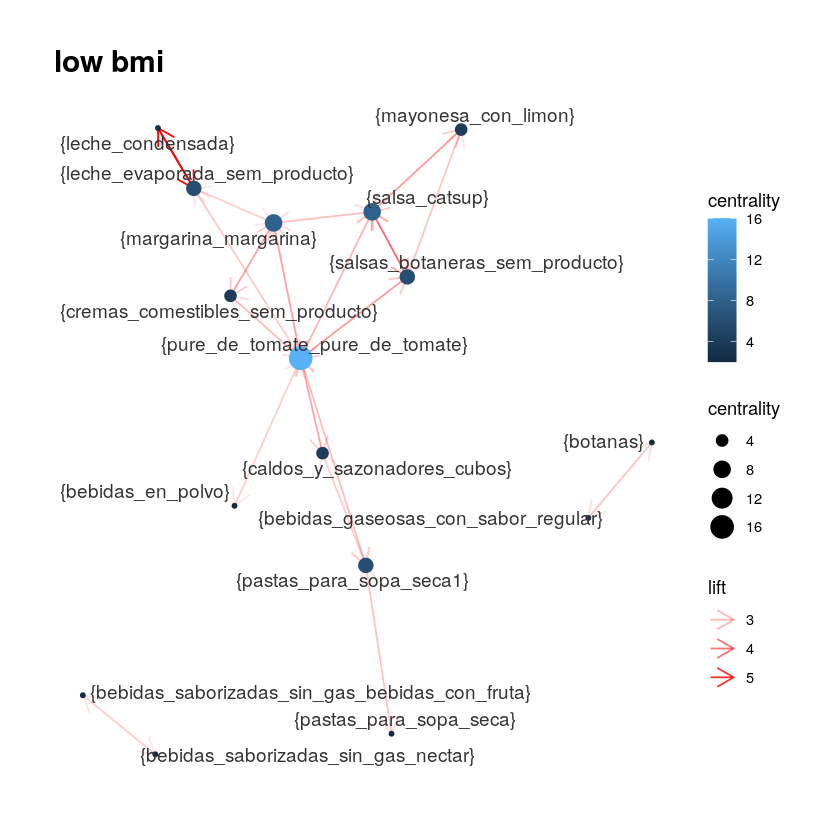

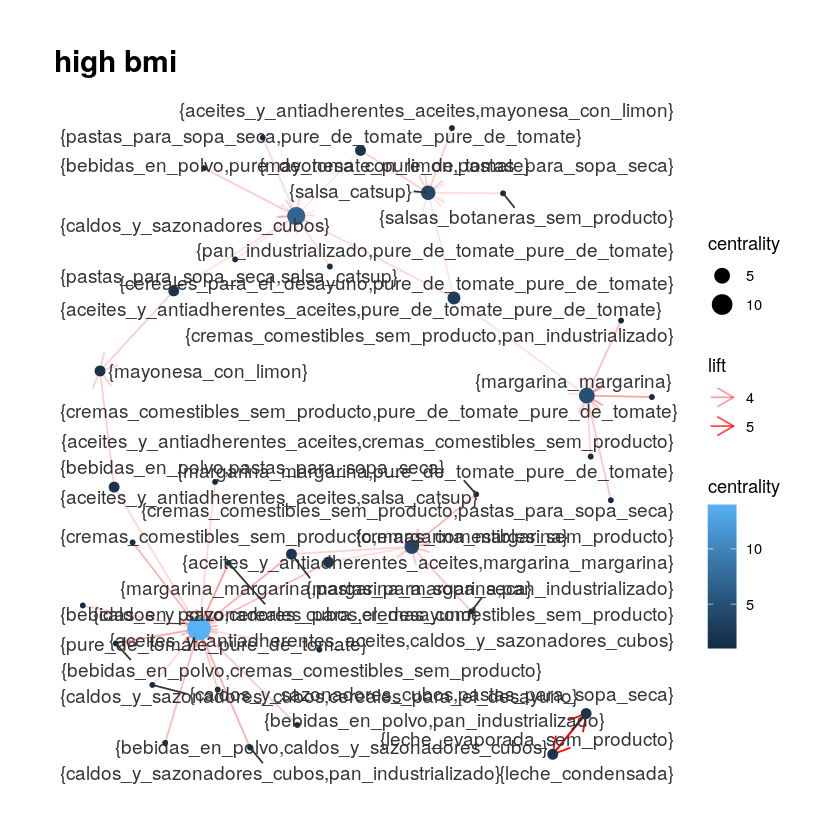

In [125]:
### Reglas con hyperlift alto
reglas_1_low <- subset(reglas_recetas_low, hyper_lift > 2.2 & confidence > 0.1) 
reglas_tam_2_low <- subset(reglas_1_low, size(reglas_1_low) == 2) 

reglas_1_high <- subset(reglas_recetas_high, hyper_lift > 3 & confidence > 0.2)
reglas_tam_2_high <- subset(reglas_1_high, size(reglas_1_low) == 2)

# Grafica



df_reglas <- reglas_tam_2_low |> DATAFRAME() |> 
  rename(from=LHS, to=RHS) |> as_data_frame()
df_reglas$weight <- log(df_reglas$hyper_lift)
graph_1 <- as_tbl_graph(df_reglas) |>
  mutate(centrality = centrality_degree(mode = "all")) 
ggraph(graph_1, layout = 'fr', start.temp=100) +
  geom_edge_link(aes(alpha=lift), 
                 colour = 'red',
                 arrow = arrow(length = unit(4, 'mm'))) + 
  geom_node_point(aes(size = centrality, colour = centrality)) + 
  geom_node_text(aes(label = name), size=4,
                 colour = 'gray20', repel=TRUE) +
  theme_graph(base_family = "sans") +
ggtitle("low bmi")

df_reglas <- reglas_tam_2_high |> DATAFRAME() |> 
  rename(from=LHS, to=RHS) |> as_data_frame()
df_reglas$weight <- log(df_reglas$hyper_lift)
graph_1 <- as_tbl_graph(df_reglas) |>
  mutate(centrality = centrality_degree(mode = "all")) 
ggraph(graph_1, layout = 'fr', start.temp=100) +
  geom_edge_link(aes(alpha=lift), 
                 colour = 'red',
                 arrow = arrow(length = unit(4, 'mm'))) + 
  geom_node_point(aes(size = centrality, colour = centrality)) + 
  geom_node_text(aes(label = name), size=4,
                 colour = 'gray20', repel=TRUE) +
  theme_graph(base_family = "sans") +
ggtitle("high bmi")

Parece ser que quienes tienen bajo BMI tienden a consumir más platillos hogareños, mientras que en el caso contrario tienden a variar más su dieta y por eso aparecen más cluters en la segunda gráfica. Las reglas de asociación de bajo BMI muestran un hyper_lift bajo, mientras que aunque cambiamos el parámetro de la gráfica para BMI alto, la gráfica no cambiaba mucho. Entonces, las reglas para BMI alto muestran una asociación muy fuerte y diversa. Sería interesante incluir interacciones con NSE y educación en un futuro.

## Análisis por año

Por último, realizamos un analísis por año, para intentar observar cambios en las reglas de asociación en el tiempo. De este analísis concluimos dos cosas:

1. Observamos que a lo largo de los años los itemsets frecuentes son muy parecidos, y que las reglas de asociación son las mismas (y las ya mencionadas, entre artículos de limpieza, salsas, botanas y refrescos, etc.)
2. En ciertos años hay asociaciones con cierto producto muy fuertes, y en otros años se quitan. Por ejemplo, en el 2013 hay una asociación fuerte entre desodorante y crema para la piel, en un cluster con otros artículos que si salen todos los años como shampoo, pero crema para la piel solo sale ese año.

In [126]:
canastas_2010 <- datosAnuales(clean2010)
canastas_2011 <- datosAnuales(clean2011)
canastas_2012 <- datosAnuales(clean2012)
canastas_2013 <- datosAnuales(clean2013)
canastas_2014 <- datosAnuales(clean2014)


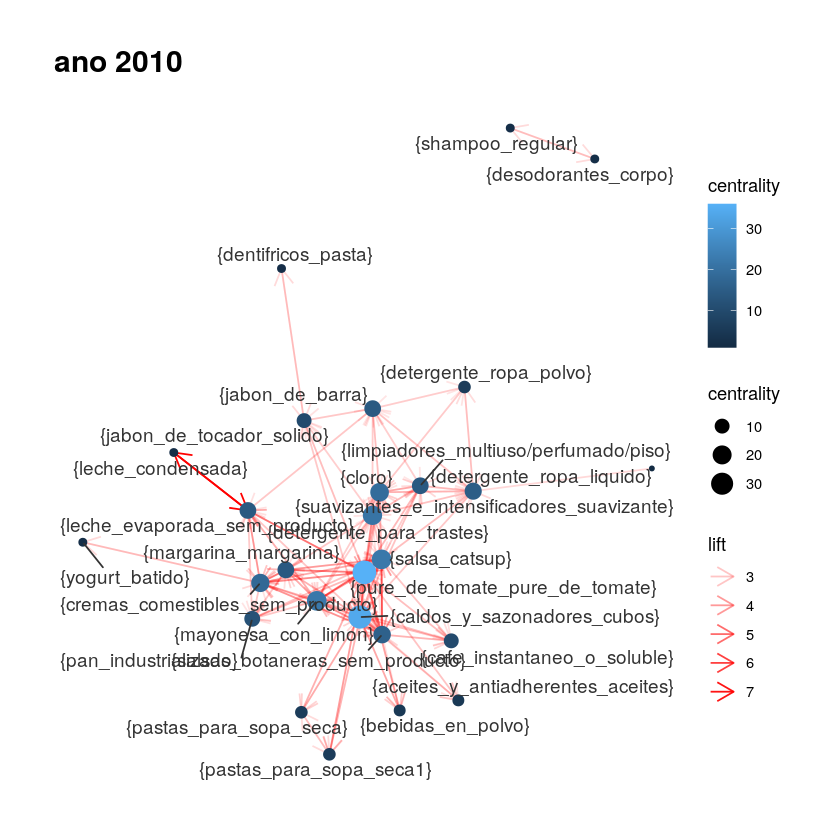

In [127]:
graficas(canastas_2010, 2.2, 2010)

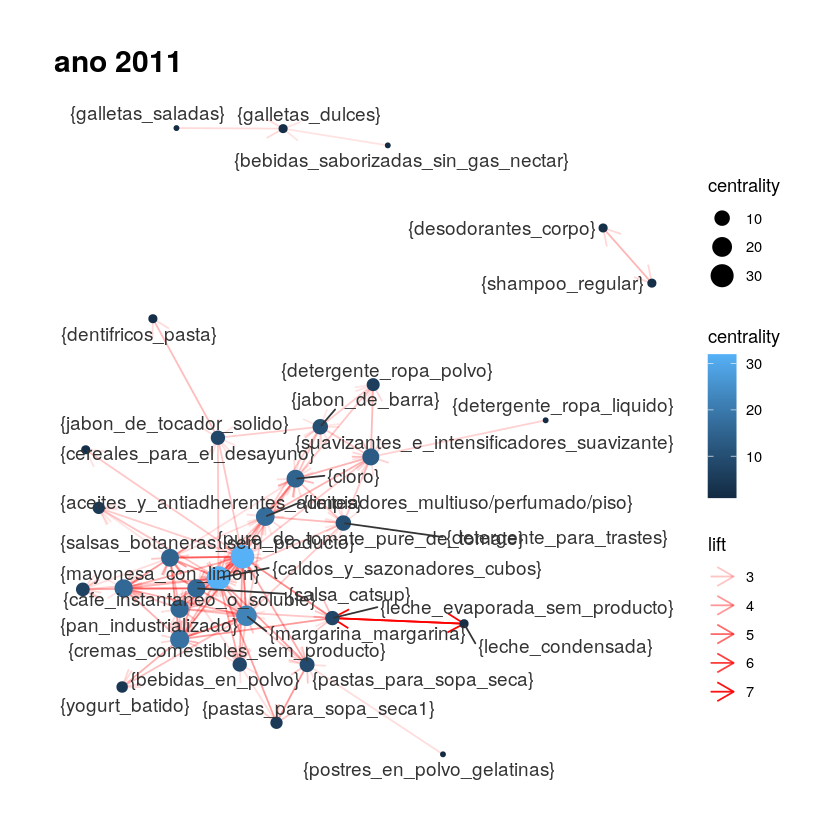

In [128]:
graficas(canastas_2011, 2.2, 2011)

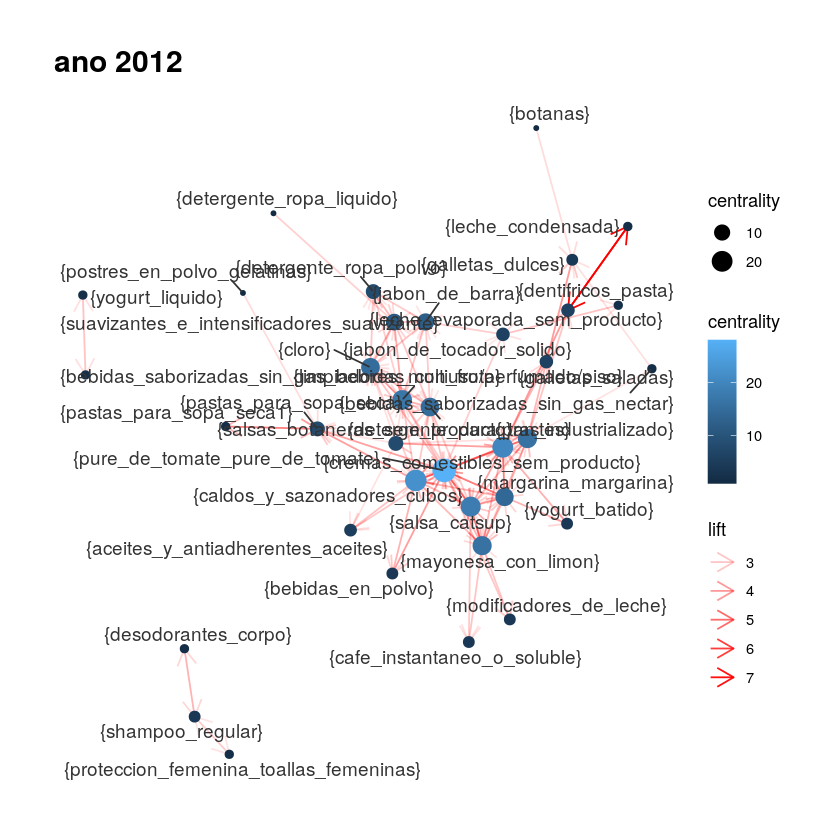

In [129]:
graficas(canastas_2012, 2.2, 2012)

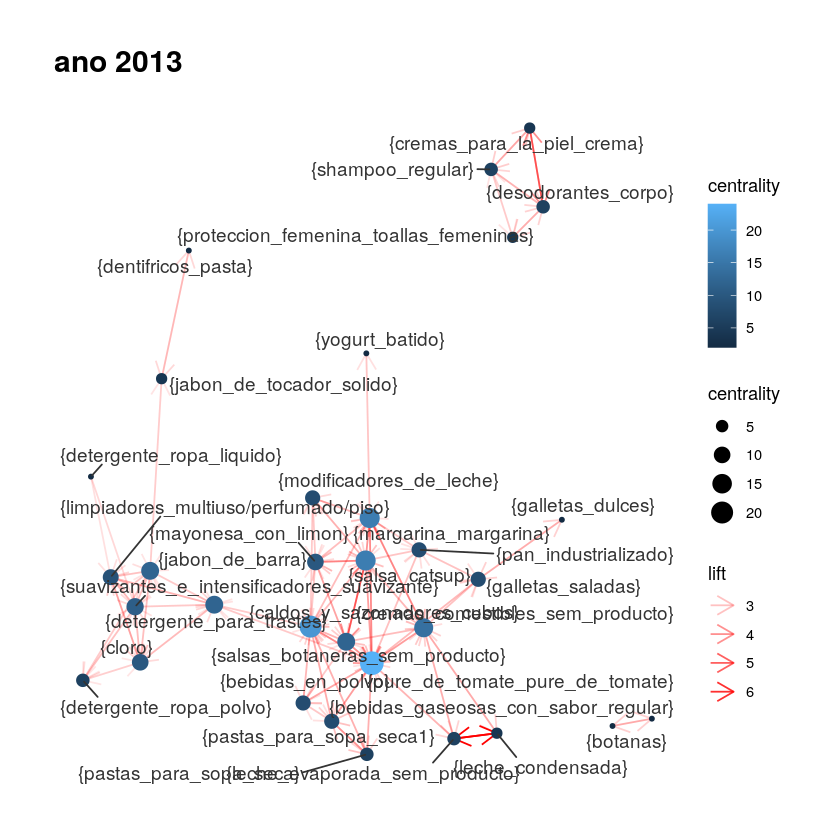

In [130]:
graficas(canastas_2013, 2.2, 2013)

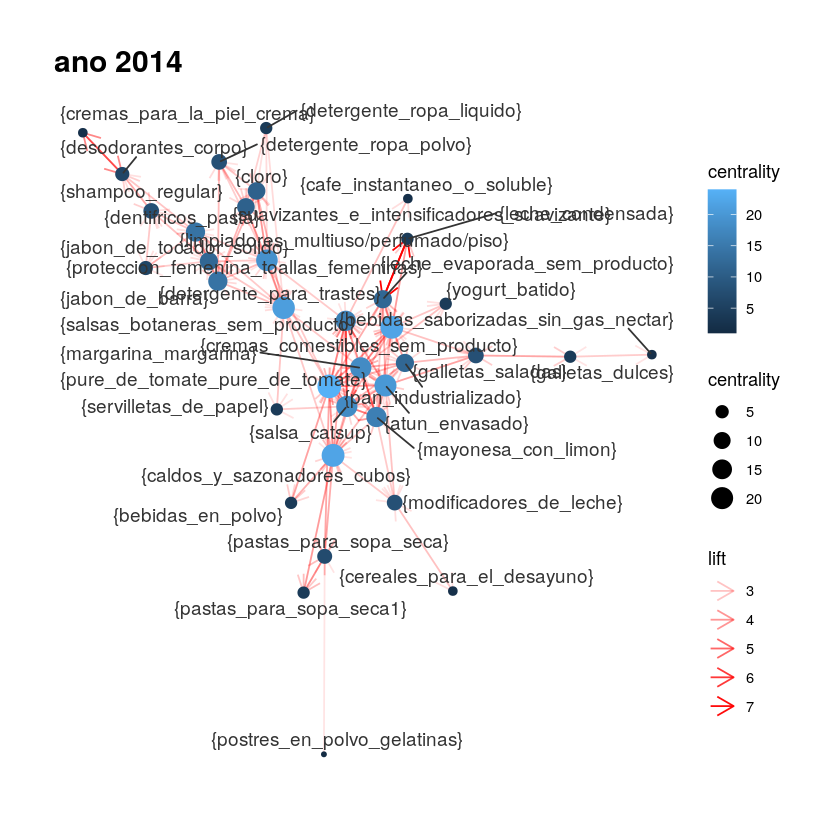

In [131]:
graficas(canastas_2014, 2.2, 2014)